<a href="https://colab.research.google.com/github/EnaJeong/LogInAndOut-log-severity-level-analysis/blob/yunsoo/wordcloud_of_masked_words.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import numpy as np
import pandas as pd
import matplotlib as mpl
from wordcloud import WordCloud
import collections
from matplotlib import font_manager, rc

font_path = '/content/drive/MyDrive/D2Coding.ttf'
font_name = font_manager.FontProperties(
    fname=font_path).get_name()

In [ ]:
train = pd.read_csv('/content/drive/MyDrive/train_masked_drop.csv')

In [ ]:
train['full_log']=train['full_log'].str.replace('[^\w\s\<\>]', ' ', regex=True)

In [ ]:
train['full_log']=train['full_log'].str.replace('_', ' ', regex=True)

In [ ]:
train['full_log']=train['full_log'].str.replace(' +', ' ', regex=True)

In [ ]:
train_text = train.full_log
train_text = train_text.str.strip() 

In [ ]:
%%time
word_set = set()
for x in train_text:
    word_set.update(x.split(' '))

len(word_set) # 띄어쓰기로 토크나이징했을 때 단어 개수

CPU times: user 3.23 s, sys: 1.13 ms, total: 3.23 s
Wall time: 3.23 s


In [ ]:
train['spaced'] = train_text
train

,id,level,full_log,spaced
0,0,0,<DATE> <TIME> localhost kibana type error time...,<DATE> <TIME> localhost kibana type error time...
1,1,0,<DATE> <TIME> localhost logstash <TS> <NUM> IN...,<DATE> <TIME> localhost logstash <TS> <NUM> IN...
2,2,0,<DATE> <TIME> localhost kibana type error time...,<DATE> <TIME> localhost kibana type error time...
3,3,0,<DATE> <TIME> localhost kibana type error time...,<DATE> <TIME> localhost kibana type error time...
4,4,1,type SYSCALL msg audit <NUM> <NUM> <NUM> arch ...,type SYSCALL msg audit <NUM> <NUM> <NUM> arch ...
...,...,...,...,...
472545,472967,0,<DATE> <TIME> localhost logstash <NUM> error,<DATE> <TIME> localhost logstash <NUM> error
472546,472968,1,type SYSCALL msg audit <NUM> <NUM> <NUM> arch ...,type SYSCALL msg audit <NUM> <NUM> <NUM> arch ...
472547,472969,0,<DATE> <TIME> localhost kibana type log timest...,<DATE> <TIME> localhost kibana type log timest...
472548,472970,0,<DATE> <TIME> localhost kibana type error time...,<DATE> <TIME> localhost kibana type error time...


In [ ]:
one_sentences = []

for level in train['level'].unique(): # level 0~6
    temp = train[train['level'] == level]['spaced'] # 해당 level에 해당되는 spaced 데이터들
    one_sentence = ' '.join(list(temp))
    one_sentences.append(one_sentence)
    
df_one_sentences = pd.DataFrame({'level':train['level'].unique(), 'log':one_sentences})

In [ ]:
df_one_sentences # level 별 띄어쓰기 토큰

,level,log
0,0,<DATE> <TIME> localhost kibana type error time...
1,1,type SYSCALL msg audit <NUM> <NUM> <NUM> arch ...
2,3,<DATE> <TIME> localhost systemd Unit esild ml ...
3,5,ossec output netstat listening ports tcp <IP> ...
4,2,The average number of logs between <NUM> <NUM>...
5,4,<DATE> <TIME> localhost sshd <NUM> Did not rec...
6,6,<DATE> <TIME> localhost sshd <NUM> Bad protoco...


In [ ]:
train[train['level']==4]

,id,level,full_log,spaced
64870,64919,4,<DATE> <TIME> localhost sshd <NUM> Did not rec...,<DATE> <TIME> localhost sshd <NUM> Did not rec...
85293,85354,4,<DATE> <TIME> sv260 sshd <NUM> Did not receive...,<DATE> <TIME> sv260 sshd <NUM> Did not receive...
122962,123069,4,<DATE> <TIME> localhost sshd <NUM> Did not rec...,<DATE> <TIME> localhost sshd <NUM> Did not rec...
167026,167164,4,<DATE> <TIME> sv260 sshd <NUM> Did not receive...,<DATE> <TIME> sv260 sshd <NUM> Did not receive...
184331,184483,4,<DATE> <TIME> sv260 sshd <NUM> Did not receive...,<DATE> <TIME> sv260 sshd <NUM> Did not receive...
229935,230131,4,<DATE> <TIME> sv260 sshd <NUM> Did not receive...,<DATE> <TIME> sv260 sshd <NUM> Did not receive...
321248,321526,4,<DATE> <TIME> localhost sshd <NUM> Did not rec...,<DATE> <TIME> localhost sshd <NUM> Did not rec...
347748,348055,4,<DATE> <TIME> localhost sshd <NUM> Did not rec...,<DATE> <TIME> localhost sshd <NUM> Did not rec...
348377,348684,4,<DATE> <TIME> localhost sshd <NUM> Did not rec...,<DATE> <TIME> localhost sshd <NUM> Did not rec...
369521,369842,4,<DATE> <TIME> sv260 sshd <NUM> Did not receive...,<DATE> <TIME> sv260 sshd <NUM> Did not receive...


# WordCloud

In [ ]:
import matplotlib as mpl
from wordcloud import WordCloud
import collections
from matplotlib import font_manager, rc
import matplotlib.pyplot as plt

font_path = '/content/drive/MyDrive/D2Coding.ttf'
font_name = font_manager.FontProperties(
    fname=font_path).get_name()

In [ ]:
df_one_sentences.iloc[2].level

3

In [ ]:
df_one_sentences.iloc[6].log

'<DATE> <TIME> localhost sshd <NUM> Bad protocol version identification <NUM> from <IP> port <NUM> <DATE> <TIME> localhost kernel device virbr0 nic entered promiscuous mode <DATE> <TIME> localhost kernel device enp2s0 entered promiscuous mode <DATE> <TIME> localhost useradd <NUM> new group name test GID <NUM> <DATE> <TIME> localhost sshd <NUM> error maximum authentication attempts exceeded for root from <IP> port <NUM> ssh2 preauth <DATE> <TIME> localhost kernel device virbr0 nic entered promiscuous mode <DATE> <TIME> localhost kernel device virbr0 nic entered promiscuous mode <DATE> <TIME> localhost kernel device enp2s0 entered promiscuous mode'

level :  0


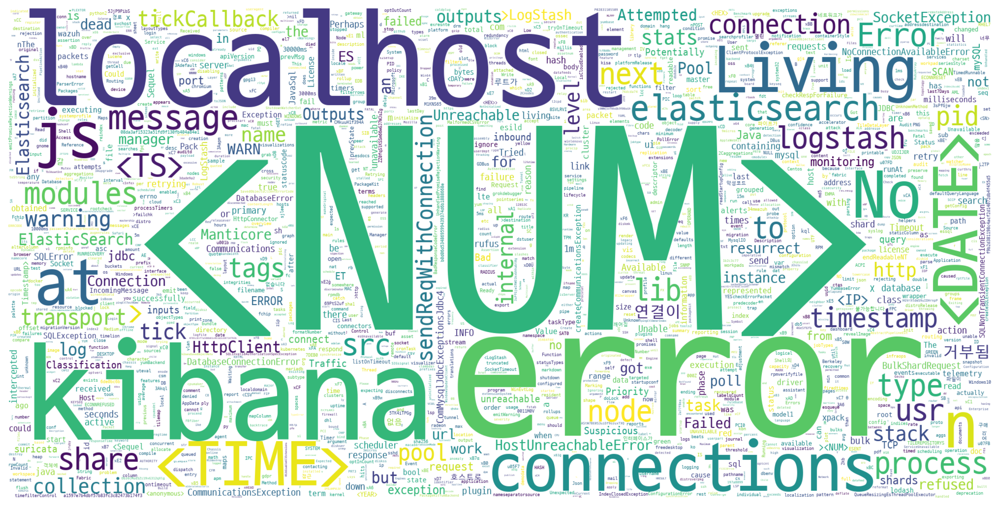

level :  1


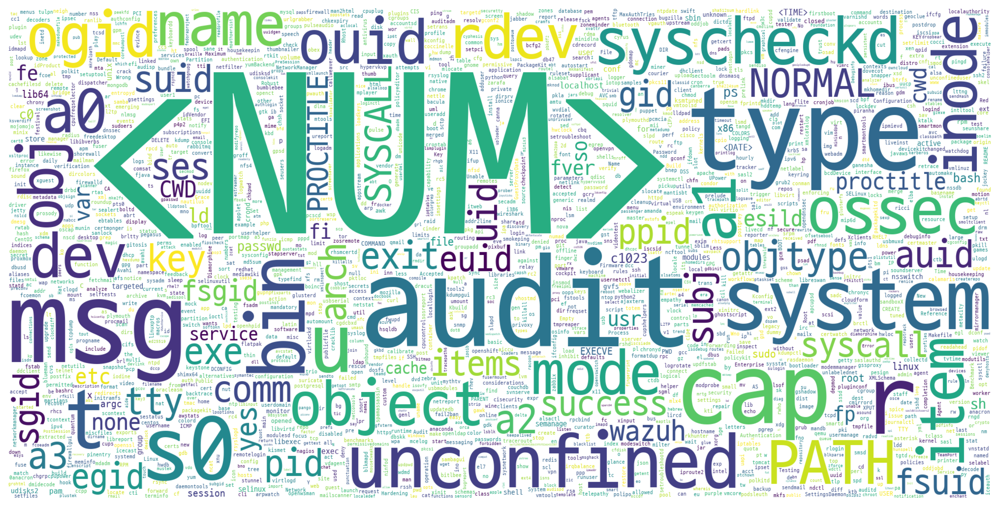

level :  3


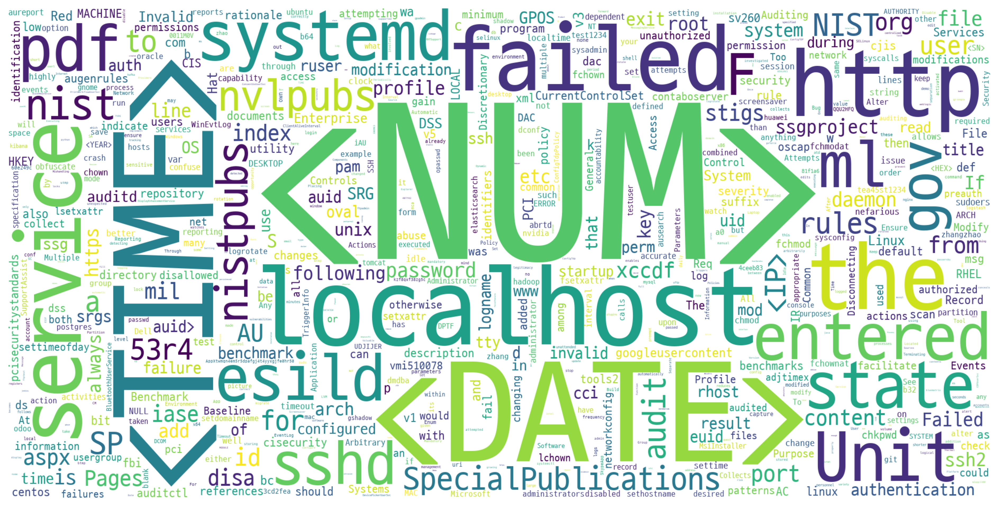

level :  5


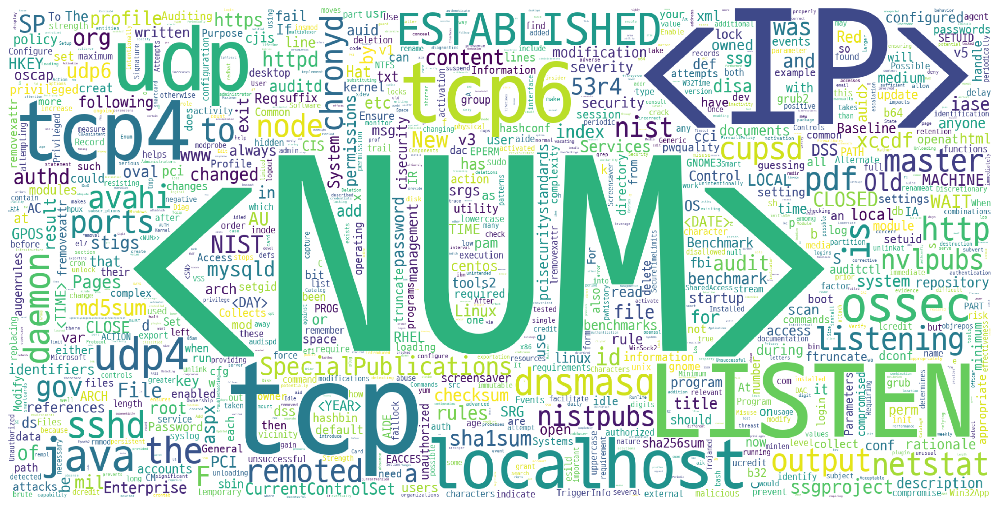

level :  2


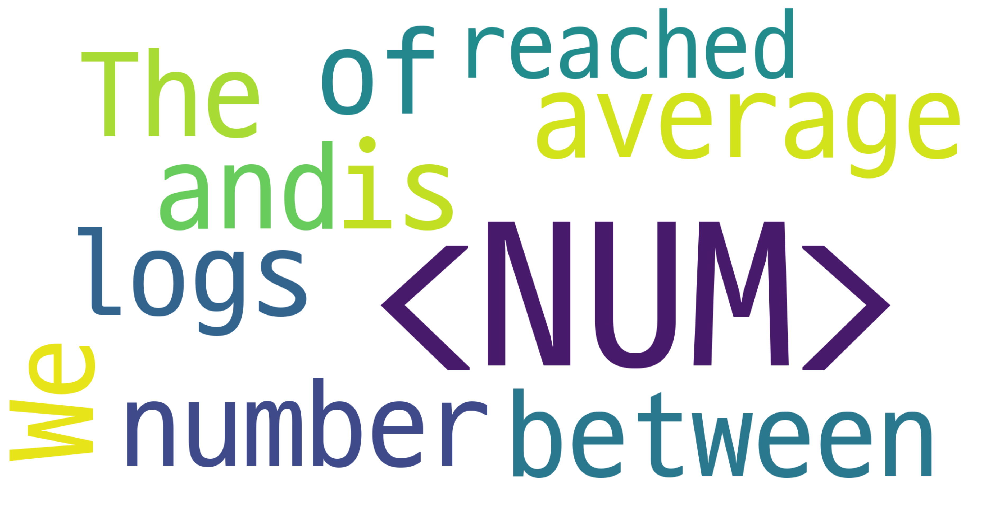

level :  4


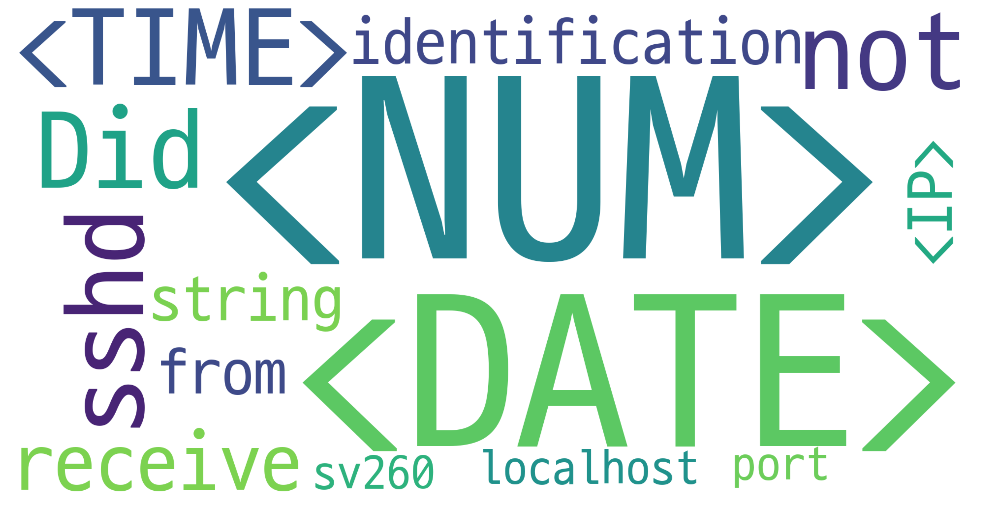

level :  6


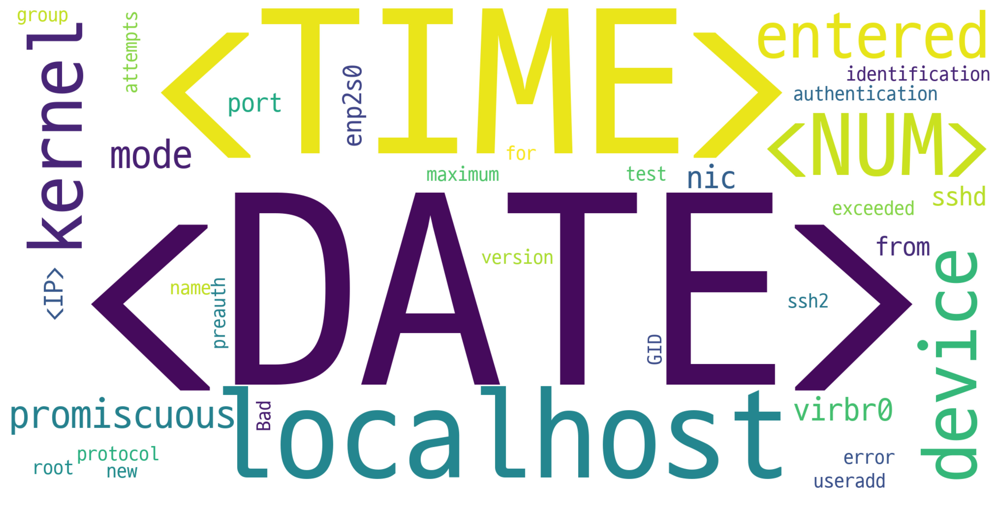

In [ ]:
stopwords = []

for i in range(7):
    print('level : ', df_one_sentences.iloc[i].level)
    level_index = i
    words = df_one_sentences.iloc[i].log.split(' ')
    worddict = collections.Counter(words)
    
    # stopwords not working
    for key in stopwords:
        del worddict[key]

    wordcloud_img = WordCloud(
            background_color='white',
            width=2000, height=1000,
            max_words=2000,
            font_path=font_path,
            stopwords=stopwords).generate_from_frequencies(worddict)

    plt.figure(figsize=(16,9), dpi=300)
    plt.imshow(wordcloud_img, interpolation='bilinear')
    plt.axis('off')
    plt.show()
    wordcloud_img.to_file('level{}.png'.format(df_one_sentences.iloc[i].level))
    # plt.savefig('level{}.png'.format(df_one_sentences.iloc[i].level), dpi=300)